In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [3]:
import timm
import matplotlib.pyplot as plt
import torch
import torchvision.transforms.functional as F
from pytorch_grad_cam import GradCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image

from notebooks_utils import get_data, get_adv_examples, show_grid

In [4]:
plt.rcParams["savefig.bbox"] = 'tight'
device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")

In [5]:
# Set up model
CHECKPOINTS_DIR = "../checkpoints"

xcit_checkpoint_file = "xcit-imagenet-4.pth.tar"
xcit_model_name = "xcit_small_12_p16_224"
xcit = timm.create_model(xcit_model_name, checkpoint_path=os.path.join(CHECKPOINTS_DIR, xcit_checkpoint_file))
xcit = xcit.to(device)

resnet_checkpoint_file = "resnet-imagenet-4.pth.tar"
resnet_model_name = "resnet50"
resnet = timm.create_model(resnet_model_name, checkpoint_path=os.path.join(CHECKPOINTS_DIR, resnet_checkpoint_file))
resnet = resnet.to(device)

In [6]:
n_examples = 16

In [7]:
xcit_x, xcit_x_adv, xcit_y = get_adv_examples(xcit, device, n_examples)

In [8]:
resnet_x, resnet_x_adv, resnet_y = get_adv_examples(resnet, device, n_examples)

In [9]:
assert torch.all(resnet_x == xcit_x)
assert torch.all(resnet_y == xcit_y)
x, y = xcit_x, xcit_y

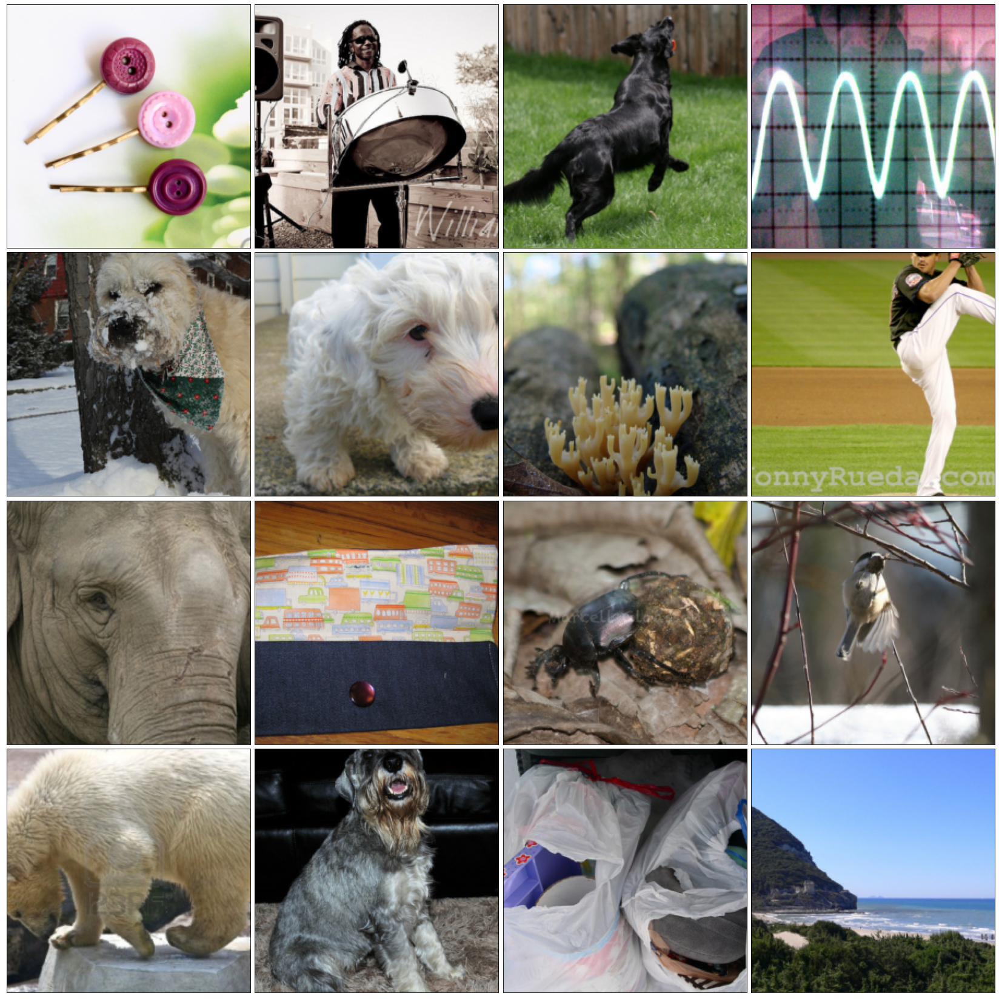

In [10]:
show_grid(x)

In [11]:
def reshape_transform(x, H=14, W=14):
    B, N, C = x.shape
    return x.permute(0, 2, 1).reshape(B, C, H, W)

targets = [ClassifierOutputTarget(l) for l in y]

xcit_target_layers = [xcit.blocks[-1].norm1]
with GradCAM(model=xcit, target_layers=xcit_target_layers, use_cuda=True, reshape_transform=reshape_transform) as cam:
    xcit_benign_cam = cam(input_tensor=x, targets=targets, aug_smooth=True, eigen_smooth=True)
    xcit_adv_cam = cam(input_tensor=xcit_x_adv, targets=targets, aug_smooth=True, eigen_smooth=True)

resnet_target_layers = [resnet.layer4[-1]]
with GradCAM(model=resnet, target_layers=resnet_target_layers, use_cuda=True) as cam:
    resnet_benign_cam = cam(input_tensor=x, targets=targets, aug_smooth=True, eigen_smooth=True)
    resnet_adv_cam = cam(input_tensor=resnet_x_adv, targets=targets, aug_smooth=True, eigen_smooth=True)    

In [12]:
import numpy as np
import torchvision.transforms.functional as F

def make_viz_single(im, im_gradcam):
    im = np.asarray(F.to_pil_image(im)) / 255
    return show_cam_on_image(im, im_gradcam, use_rgb=True)


def make_viz(ims, ims_gradcam):
    return torch.stack([torch.from_numpy(make_viz_single(im, gradcam)).permute(2, 0, 1) for im, gradcam in zip(ims, ims_gradcam)])

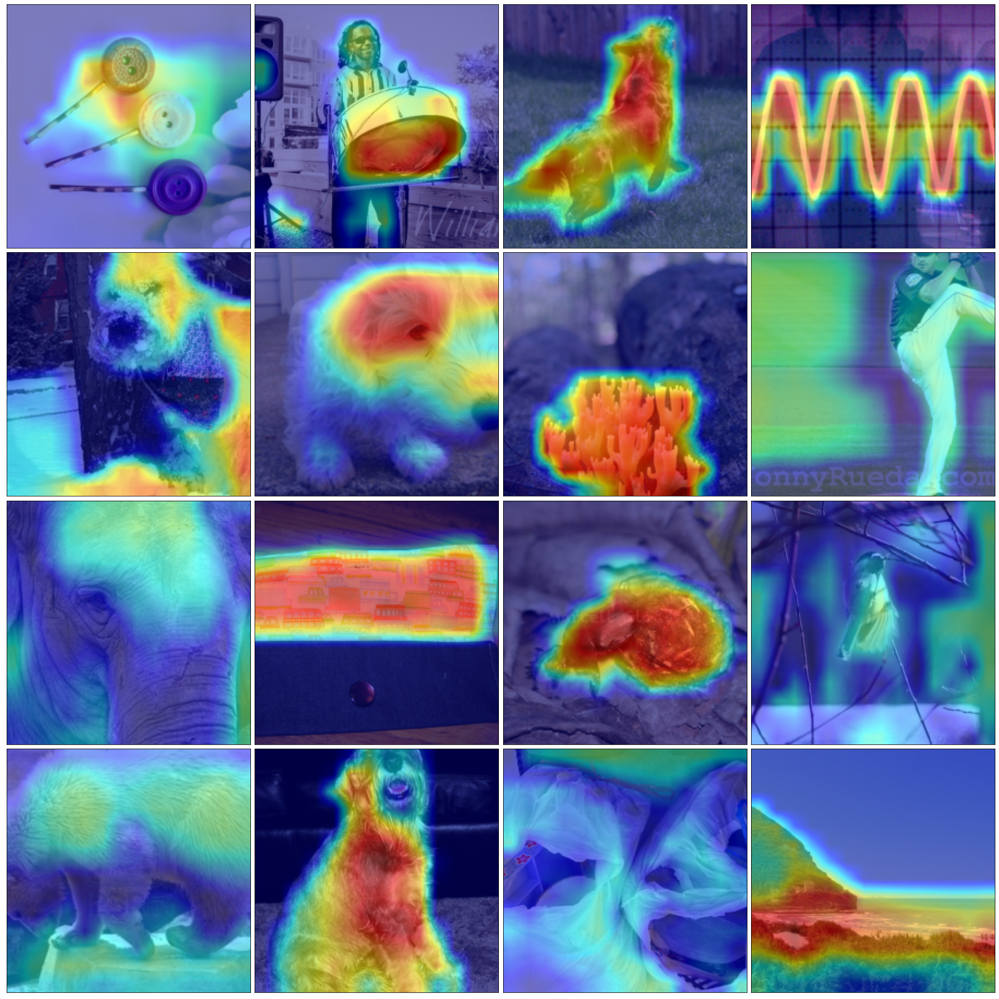

In [13]:
show_grid(make_viz(x, xcit_benign_cam))

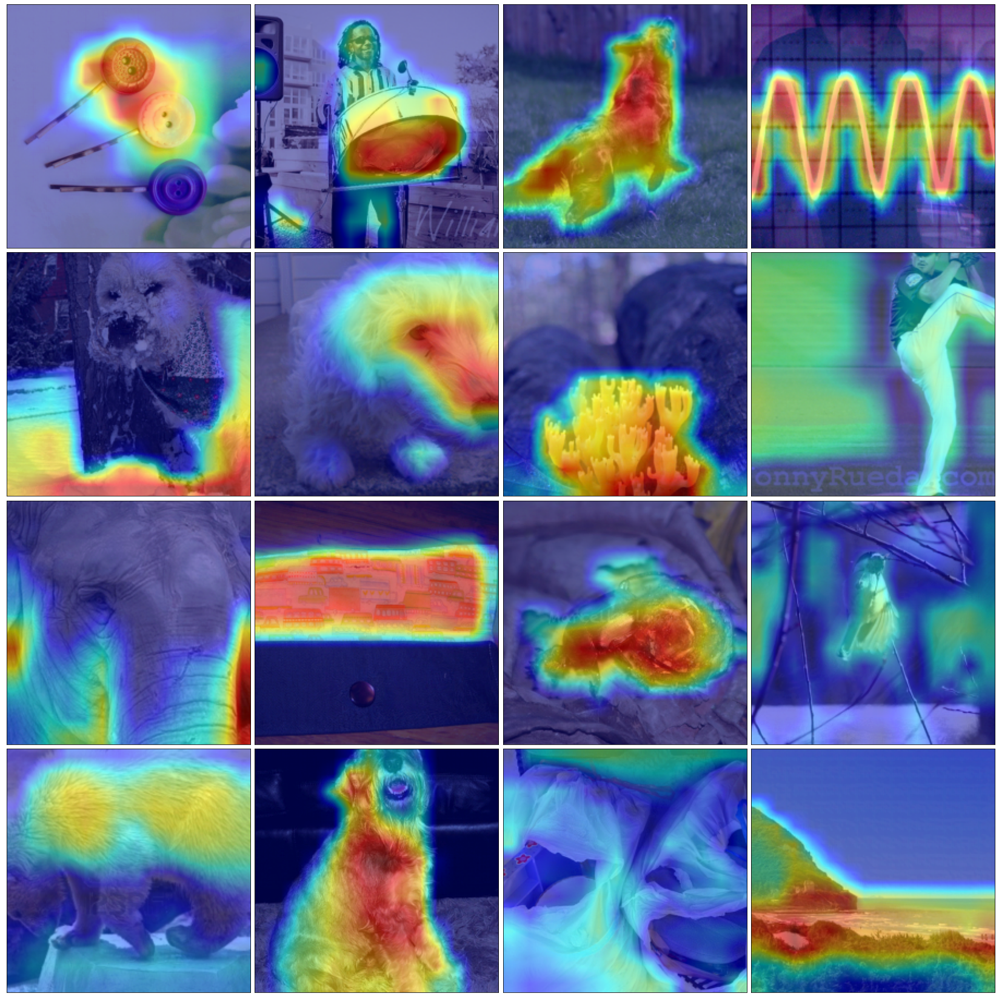

In [14]:
show_grid(make_viz(xcit_x_adv, xcit_adv_cam))

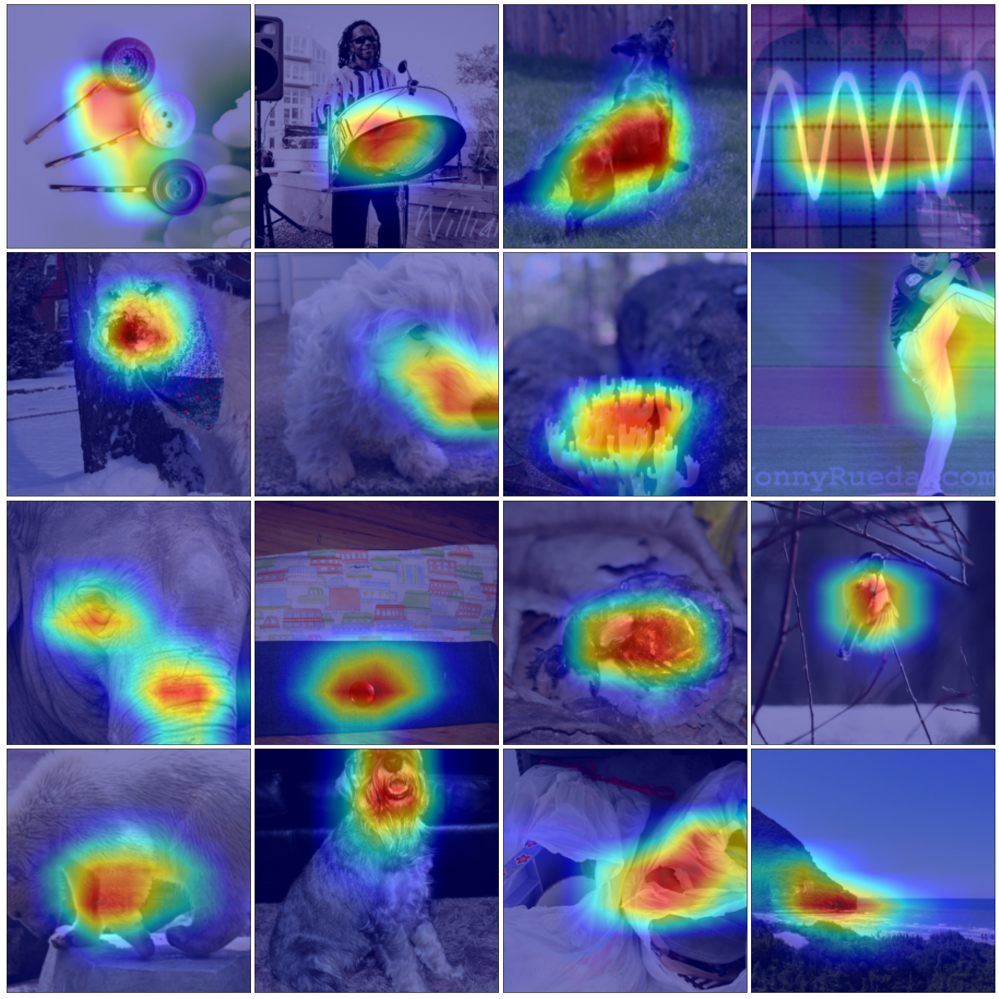

In [15]:
show_grid(make_viz(x, resnet_benign_cam))

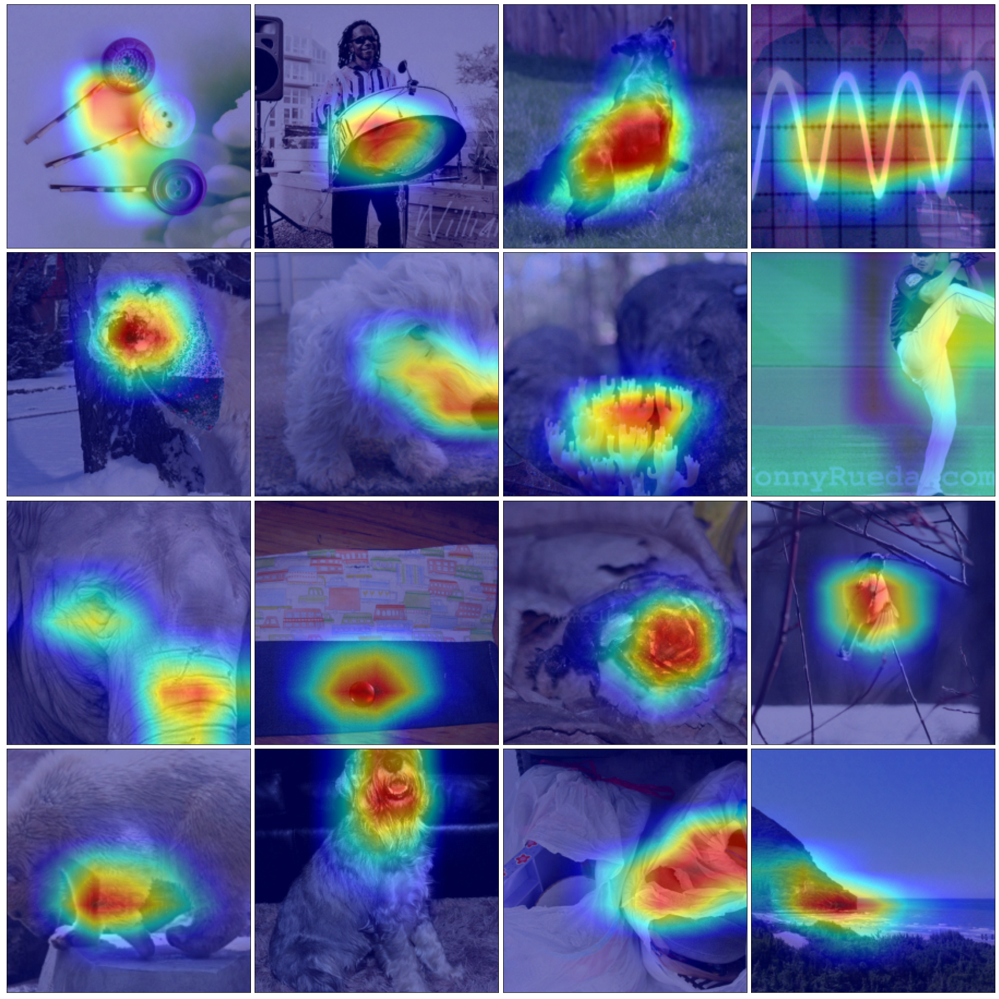

In [16]:
show_grid(make_viz(resnet_x_adv, resnet_adv_cam))